In [1]:
%load_ext nb_black

<IPython.core.display.Javascript object>

In [2]:
import pandas as pd
import numpy as np

import geopandas as gpd
import geojson

import branca.colormap as cm
import matplotlib.pyplot as plt
import descartes

import folium
from folium.plugins import TimeSliderChoropleth

<IPython.core.display.Javascript object>

In [3]:
# reading and Prepping Data
fp = "laucntycur14_data.csv"
df = pd.read_csv(fp, encoding='cp1252')

<IPython.core.display.Javascript object>

In [4]:
# Drop NAN Values
df.dropna(inplace=True)

<IPython.core.display.Javascript object>

In [5]:
# subsetting for Texas Counties
texas_data = df.loc[df['County Name/State Abbreviation'].str.contains('TX')]

<IPython.core.display.Javascript object>

In [6]:
# Display Texas Data
texas_data.head()

,LAUS Code,State FIPS Code,County FIPS Code,County Name/State Abbreviation,Period,Labor Force,Employed,Unemployed,Unemployment Rate (%)
2523,CN4800100000000,48.0,1.0,"Anderson County, TX",19-Nov,"24,148","23,468",680,2.8
2524,CN4800300000000,48.0,3.0,"Andrews County, TX",19-Nov,"9,863","9,632",231,2.3
2525,CN4800500000000,48.0,5.0,"Angelina County, TX",19-Nov,"36,071","34,659","1,412",3.9
2526,CN4800700000000,48.0,7.0,"Aransas County, TX",19-Nov,"9,445","9,072",373,3.9
2527,CN4800900000000,48.0,9.0,"Archer County, TX",19-Nov,"4,154","4,043",111,2.7


<IPython.core.display.Javascript object>

In [7]:
# Read in Texas Countries Shapefile
counties = gpd.read_file("County.shp")

<IPython.core.display.Javascript object>

<AxesSubplot:>

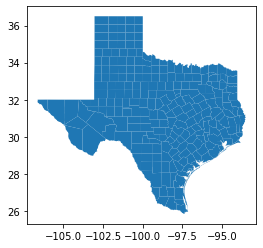

<IPython.core.display.Javascript object>

In [8]:
# Plot Shapefile Data
counties.plot()

In [9]:
# Matching Number of Unique Instances demonstrates Column Equivalency
texas_data['County Name/State Abbreviation'].nunique() == counties['CNTY_NM'].nunique()

True

<IPython.core.display.Javascript object>

In [10]:
# split Counties column to two (2) columns
texas_data[['County','TX_str']] = texas_data['County Name/State Abbreviation'].str.split(',',expand=True)
texas_data[['County','county_str']] = texas_data['County'].str.split(' ',1, expand=True)

/srv/conda/envs/notebook/lib/python3.8/site-packages/pandas/core/frame.py:2963: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


<IPython.core.display.Javascript object>

In [11]:
# Subset for only the needed columns
texas_data = texas_data[['County', 'Period', 'Unemployment Rate (%)']]
counties = counties[['CNTY_NM', 'geometry']]

<IPython.core.display.Javascript object>

In [12]:
# Rename the counties['CNTY_FIPS'] column
counties.rename(columns={'CNTY_NM': 'County'}, inplace=True)

<IPython.core.display.Javascript object>

In [13]:
# Clean the Period Col
texas_data['Period'] = texas_data['Period'].replace({' p':''}, regex=True)

<IPython.core.display.Javascript object>

In [14]:
from datetime import datetime as dt
# define a function to convert dates
def format_malformed_date(x):
    return dt.strptime(x, '%b-%y').strftime('%B-%Y')

def format_date(x):
    return dt.strptime(x, '%y-%b').strftime('%B-%Y')

<IPython.core.display.Javascript object>

In [15]:
# apply conversion to desired column and store output to new column
texas_data.update(texas_data['Period'].loc[texas_data['Period'] == 'Dec-20'].apply(lambda x: format_malformed_date(x)))

<IPython.core.display.Javascript object>

In [16]:
# apply conversion to desired column and store output to new column
texas_data.update(texas_data['Period'].loc[texas_data['Period'] != 'December-2020'].apply(lambda x: format_date(x)))

<IPython.core.display.Javascript object>

In [17]:
# convert to integer & divide by 10^9 to get the unix time in nanoseconds 
texas_data['Period'] = pd.to_datetime(texas_data['Period']).astype(int) / 10**9

<IPython.core.display.Javascript object>

In [18]:
# convert the Period to unix time in nanoseconds
texas_data['Period'] = texas_data['Period'].astype(str)

<IPython.core.display.Javascript object>

In [19]:
# joined shapefile and unemployment data
joined_df = texas_data.merge(counties, on='County')

<IPython.core.display.Javascript object>

In [20]:
joined_df = joined_df.reset_index(drop=True)

<IPython.core.display.Javascript object>

In [21]:
# change Unemployment Rate to Numeric
joined_df['Unemployment Rate (%)'] = pd.to_numeric(joined_df['Unemployment Rate (%)'], errors='coerce')

<IPython.core.display.Javascript object>

In [22]:
# define a colour map in terms of the unemployment rate
max_colour = max(joined_df['Unemployment Rate (%)'])
min_colour = min(joined_df['Unemployment Rate (%)'])
cmap = cm.linear.YlOrRd_09.scale(min_colour, max_colour)
joined_df['colour'] = joined_df['Unemployment Rate (%)'].map(cmap)

<IPython.core.display.Javascript object>

In [23]:
# create the styledict
county_list = joined_df['County'].unique().tolist()
county_idx = range(len(county_list))

style_dict = {}
for i in county_idx:
    country = county_list[i]
    result = joined_df[joined_df['County'] == country]
    inner_dict = {}
    for _, r in result.iterrows():
        inner_dict[r['Period']] = {'color': r['colour'], 'opacity': 0.7}
    style_dict[str(i)] = inner_dict

<IPython.core.display.Javascript object>

In [29]:
# Austin, Texas
latitude = 30.2672
longitude = -97.7431

<IPython.core.display.Javascript object>

In [30]:
# create Folium map
Texas_Map = folium.Map(
                location = [latitude, longitude], 
                max_bounds=True, 
                control_scale=True,
                zoom_start = 5)

<IPython.core.display.Javascript object>

In [26]:
# make a dataframe containing the features for each country
joined_df = joined_df[['geometry']]
joined_gdf = gpd.GeoDataFrame(joined_df, geometry='geometry')
joined_gdf = joined_gdf.drop_duplicates().reset_index()

<IPython.core.display.Javascript object>

In [31]:
from folium.plugins import TimeSliderChoropleth

_ = TimeSliderChoropleth(
    data=joined_gdf.to_json(),
    styledict=style_dict,

).add_to(Texas_Map)

_ = cmap.add_to(Texas_Map)
cmap.caption = "Unemployment Rate: Pre-COVID - End of 2020 (%)"
Texas_Map.save(outfile='TexasUnemployment.html')

<IPython.core.display.Javascript object>

In [32]:
Texas_Map

<IPython.core.display.Javascript object>

# Data Sources
 - **Texas Unemployment Data**: US Bureau of Labor Statistics<br>
 - **Map of Texas Counties**: https://hub.arcgis.com/datasets/TXDOT::texas-county-boundaries-line 